In [83]:
# Script to read input text file into a variable

# Define the filename
filename = "/Users/agkep/OneDrive/documents/school/Code/data_repository/Mapol/nitrobenzene/exachem_QED_RHF_META.txt"

# Define conversion factor (Hartree to kcal/mol)
HARTREE_TO_kcal_mol = 627.509

# Read the file
try:
    with open(filename, "r") as file:
        data_meta = file.read()  # Load the entire file content into the variable `data`
    print("File loaded successfully!")
except FileNotFoundError:
    print(f"Error: File '{filename}' not found.")
except Exception as e:
    print(f"An error occurred: {e}")

# Process and convert energies
converted_data_meta = []
for line in data_meta.splitlines():
    parts = line.strip().rsplit(" ", 1)  # Split into two parts: before and after the last space
    if len(parts) == 2:
        before_energy = parts[0]  # Keep the part before the energy value
        try:
            energy = float(parts[1])  # Extract energy value
            converted_energy = energy * HARTREE_TO_kcal_mol  # Convert to desired unit
            converted_line = f"{before_energy} {converted_energy:.6f}"  # Format output
        except ValueError:
            converted_line = line.strip()  # Keep unchanged if conversion fails
    else:
        converted_line = line.strip()  # Keep unchanged if the format is unexpected

    converted_data_meta.append(converted_line)


# Print the first few lines of the converted data
print("\nConverted Data meta (Hartree → kcal/mol):")
print("\n".join(converted_data_meta[:5]))  # Show first 5 lines

# Print the first few lines of the data to confirm it was loaded
print("\nPreview of the data:")
print("\n".join(data_meta.splitlines()[:5]))  # Display the first 5 lines

File loaded successfully!

Converted Data meta (Hartree → kcal/mol):
[78.26086956521739, 125.21739130434783] _ -1886348.584617
[15.652173913043478, 360.0] _ -1886362.643728
[15.652173913043478, 203.47826086956522] _ -1886365.303424
[156.52173913043478, 140.8695652173913] _ -1886363.212793
[148.69565217391303, 15.652173913043478] _ -1886363.214498

Preview of the data:
[78.26086956521739, 125.21739130434783] _ -3006.0900873411774   
[15.652173913043478, 360.0] _ -3006.1124919767394   
[15.652173913043478, 203.47826086956522] _ -3006.116730475409   
[156.52173913043478, 140.8695652173913] _ -3006.1133988400456   
[148.69565217391303, 15.652173913043478] _ -3006.113401557759   


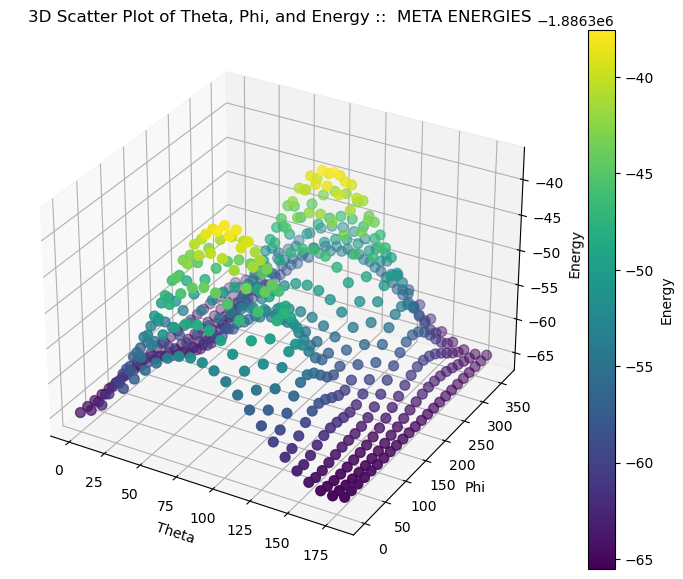

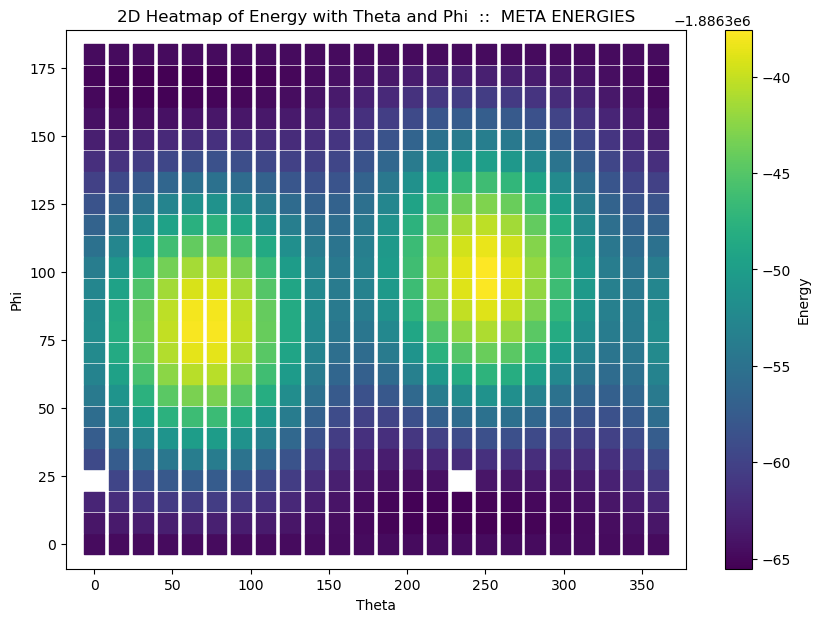

In [77]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D


# Parse the data
theta = []
phi = []
energy = []

for line in converted_data_meta:  # Use converted data instead of reading from file again
    parts = line.split("_")
    
    if len(parts) == 2:  # Ensure the split is successful
        angles = parts[0].strip().split(",")  # Strip spaces and split angles
        try:
            theta.append(float(angles[0].split("[")[1]))  # Extract and convert theta
            phi.append(float(angles[1].split("]")[0]))  # Extract and convert phi
            energy.append(float(parts[1].strip()))  # Extract converted energy
        except (ValueError, IndexError) as e:
            print(f"Skipping line due to error: {line} | Error: {e}")  # Debugging info

#for line in data_meta.strip().split("\n"):
   # parts = line.split("_")
    #print(parts)
    #angles = parts[0].split(",")
    #print(angles[0].split("[")[1])
    #print(angles[1].split("]")[0])
   # theta.append(float(angles[0].split("[")[1]))
    #phi.append(float(angles[1].split("]")[0]))
    #energy.append(float(parts[1]))

theta = np.array(theta)
phi = np.array(phi)
energy = np.array(energy)

# 3D Scatter Plot
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')
scatter = ax.scatter(theta, phi, energy, c=energy, cmap='viridis', s=50)
ax.set_xlabel("Theta")
ax.set_ylabel("Phi")
ax.set_zlabel("Energy")
plt.colorbar(scatter, label="Energy")
plt.title("3D Scatter Plot of Theta, Phi, and Energy ::  META ENERGIES")
plt.show()

# 2D Heatmap
plt.figure(figsize=(10, 7))
plt.scatter(phi, theta, c=energy, cmap='viridis', s=200, marker = 's')
plt.colorbar(label="Energy")
plt.xlabel("Theta")
plt.ylabel("Phi")
plt.title("2D Heatmap of Energy with Theta and Phi  ::  META ENERGIES")
plt.show()


In [84]:
# Script to read input text file into a variable

# Define the filename
filename = "/Users/agkep/OneDrive/documents/school/Code/data_repository/Mapol/nitrobenzene/exachem_QED_RHF_ORTHO.txt"

# Process and convert energies
converted_data_ortho = []
for line in data_ortho.splitlines():
    parts = line.strip().rsplit(" ", 1)  # Split into two parts: before and after the last space
    if len(parts) == 2:
        before_energy = parts[0]  # Keep the part before the energy value
        try:
            energy = float(parts[1])  # Extract energy value
            converted_energy = energy * HARTREE_TO_kcal_mol  # Convert to desired unit
            converted_line = f"{before_energy} {converted_energy:.6f}"  # Format output
        except ValueError:
            converted_line = line.strip()  # Keep unchanged if conversion fails
    else:
        converted_line = line.strip()  # Keep unchanged if the format is unexpected

    converted_data_ortho.append(converted_line)

# Read the file
try:
    with open(filename, "r") as file:
        data_ortho = file.read()  # Load the entire file content into the variable `data`
    print("File loaded successfully!")
except FileNotFoundError:
    print(f"Error: File '{filename}' not found.")
except Exception as e:
    print(f"An error occurred: {e}")

# Print the first few lines of the converted data
print("\nConverted Data ortho (Hartree → kcal/mol):")
print("\n".join(converted_data_ortho[:5]))  # Show first 5 lines

# Print the first few lines of the data to confirm it was loaded
print("\nPreview of the data:")
print("\n".join(data_ortho.splitlines()[:5]))  # Display the first 5 lines

File loaded successfully!

Converted Data ortho (Hartree → kcal/mol):
[39.130434782608695, 31.304347826086957] _ -1886353.316808
[101.73913043478261, 234.7826086956522] _ -1886340.470863
[133.04347826086956, 125.21739130434783] _ -1886349.111517
[180.0, 281.7391304347826] _ -1886358.124923
[140.8695652173913, 344.3478260869565] _ -1886349.637209

Preview of the data:
[39.130434782608695, 31.304347826086957] _ -3006.097628571966   
[101.73913043478261, 234.7826086956522] _ -3006.0771572412646   
[133.04347826086956, 125.21739130434783] _ -3006.0909270093466   
[180.0, 281.7391304347826] _ -3006.105290797918   
[140.8695652173913, 344.3478260869565] _ -3006.0917647547176   


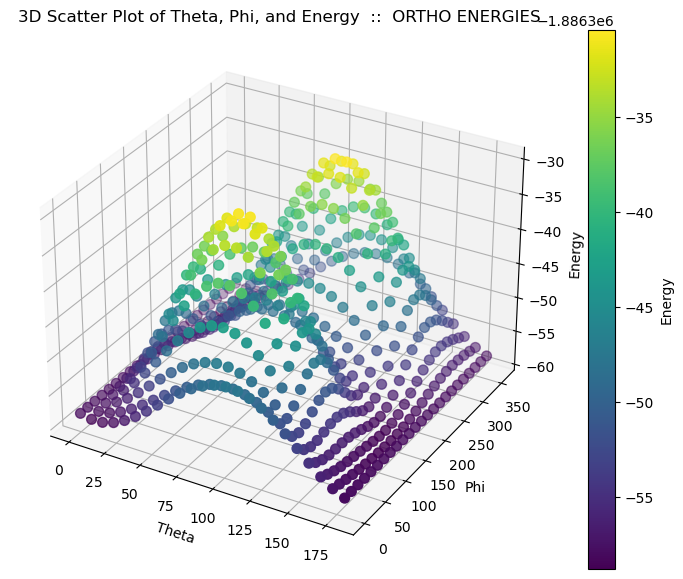

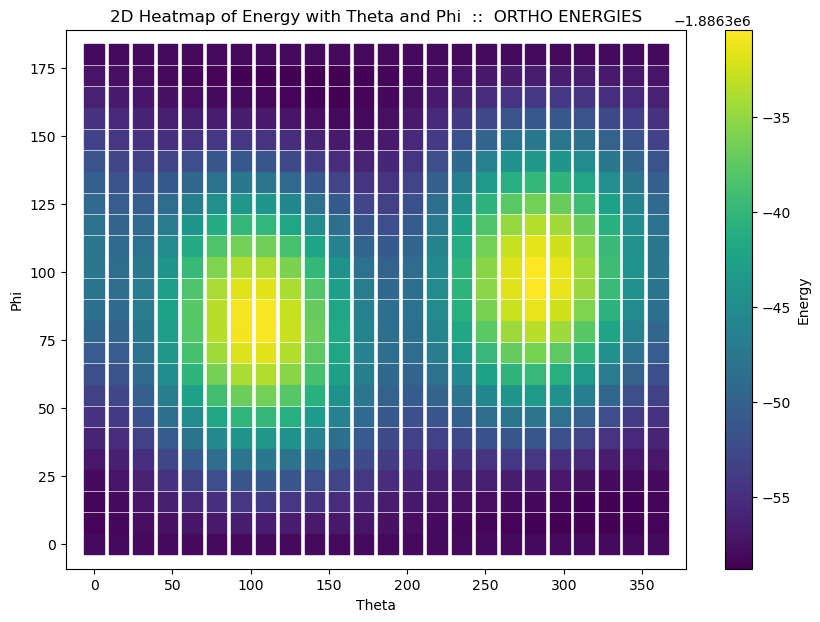

In [79]:
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D


# Parse the data
theta = []
phi = []
energy = []

for line in converted_data_ortho:  # Use converted data instead of reading from file again
    parts = line.split("_")
    
    if len(parts) == 2:  # Ensure the split is successful
        angles = parts[0].strip().split(",")  # Strip spaces and split angles
        try:
            theta.append(float(angles[0].split("[")[1]))  # Extract and convert theta
            phi.append(float(angles[1].split("]")[0]))  # Extract and convert phi
            energy.append(float(parts[1].strip()))  # Extract converted energy
        except (ValueError, IndexError) as e:
            print(f"Skipping line due to error: {line} | Error: {e}")  # Debugging info

#for line in data_ortho.strip().split("\n"):
    #parts = line.split("_")
    #print(parts)
   # angles = parts[0].split(",")
   # theta.append(float(angles[0].split("[")[1]))
   # phi.append(float(angles[1].split("]")[0]))
   # energy.append(float(parts[1]))

theta = np.array(theta)
phi = np.array(phi)
energy = np.array(energy)

# 3D Scatter Plot
fig = plt.figure(figsize=(10, 7))
ax = fig.add_subplot(111, projection='3d')
scatter = ax.scatter(theta, phi, energy, c=energy, cmap='viridis', s=50)
ax.set_xlabel("Theta")
ax.set_ylabel("Phi")
ax.set_zlabel("Energy")
plt.colorbar(scatter, label="Energy")
plt.title("3D Scatter Plot of Theta, Phi, and Energy  ::  ORTHO ENERGIES")
plt.show()

# 2D Heatmap
plt.figure(figsize=(10, 7))
plt.scatter(phi, theta, c=energy, cmap='viridis', s=200, marker = 's')
plt.colorbar(label="Energy")
plt.xlabel("Theta")
plt.ylabel("Phi")
plt.title("2D Heatmap of Energy with Theta and Phi  ::  ORTHO ENERGIES")
plt.show()

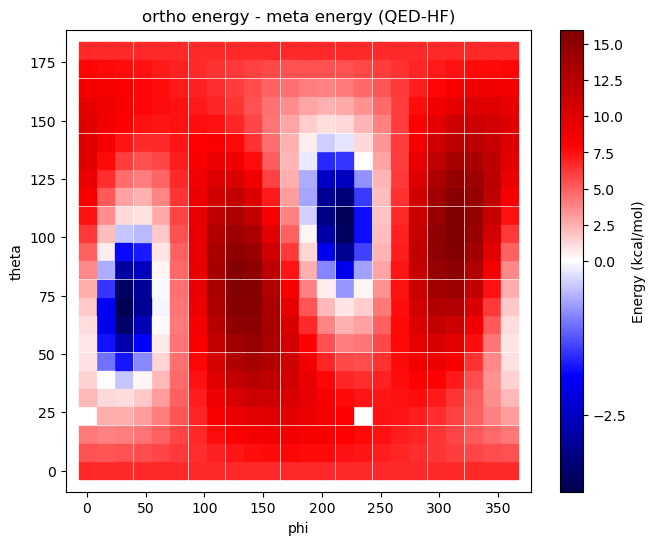

In [85]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import TwoSlopeNorm

# Define conversion factor (Hartree to kcal/mol)
HARTREE_TO_kcal_mol = 627.509

cmap = plt.get_cmap('seismic')
vmin = -0.0059619945216429875 * HARTREE_TO_kcal_mol
vmax = 0.025500426395924588 * HARTREE_TO_kcal_mol
vcenter = 0

norm = TwoSlopeNorm(vmin = vmin, vcenter=vcenter, vmax= vmax)


converted_data_ortho_unsorted = []
converted_data_meta_unsorted = []


for line in converted_data_ortho:
    parts = line.split("_")
    # print(parts)
    angles = parts[0].split(",")
    converted_data_ortho_unsorted.append(   ([float(angles[0].split("[")[1]),float(angles[1].split("]")[0]) ] , float(parts[1]))      )

#for line in converted_data_ortho.strip().split("\n"):
    #parts = line.split("_")
    #print(parts)
    #angles = parts[0].split(",")

    #converted_data_ortho_unsorted.append(   ([float(angles[0].split("[")[1]),float(angles[1].split("]")[0]) ] , float(parts[1]))      )

for line in converted_data_meta:
    parts = line.split("_")
    #print(parts)
    angles = parts[0].split(",")
    converted_data_meta_unsorted.append(   ([float(angles[0].split("[")[1]),float(angles[1].split("]")[0]) ] , float(parts[1]))      )

#for line in converted_data_meta.strip().split("\n"):
   # parts = line.split("_")
    #print(parts)
    #angles = parts[0].split(",")

   # converted_data_meta_unsorted.append(   ([float(angles[0].split("[")[1]),float(angles[1].split("]")[0]) ] , float(parts[1]))      )

# Convert data to dictionaries for easier matching
dict1 = {tuple(coord): energy for coord, energy in converted_data_ortho_unsorted}
dict2 = {tuple(coord): energy for coord, energy in converted_data_meta_unsorted}

# Find common points and calculate energy difference
common_coords = set(dict1.keys()) & set(dict2.keys())
differences = [(coord, dict1[coord] - dict2[coord]) for coord in common_coords]

# Prepare data for plotting
theta = [coord[0] for coord, diff in differences]
phi = [coord[1] for coord, diff in differences]
energy_diff = [diff for coord, diff in differences]

# Plotting
plt.figure(figsize=(7.5, 6))
sc = plt.scatter(phi, theta, c=energy_diff, cmap=cmap, s=150, marker = 's', norm = norm)
plt.title("ortho energy - meta energy (QED-HF)")
plt.xlabel("phi")
plt.ylabel("theta")
plt.colorbar(label='Energy (kcal/mol)')  # Add a color bar to represent the energy values
#plt.colorbar()
plt.show()


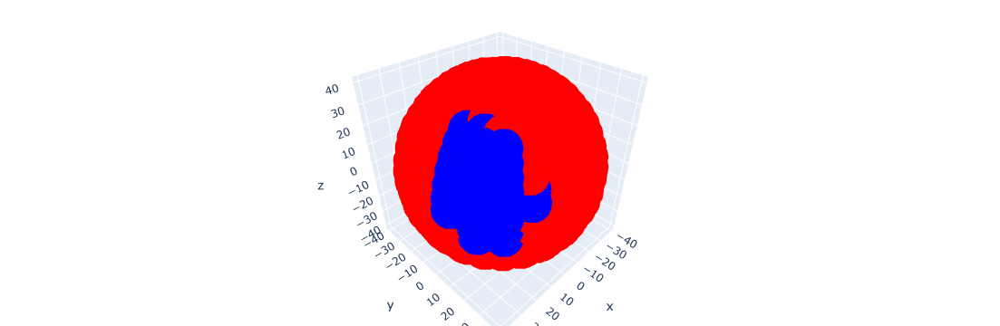

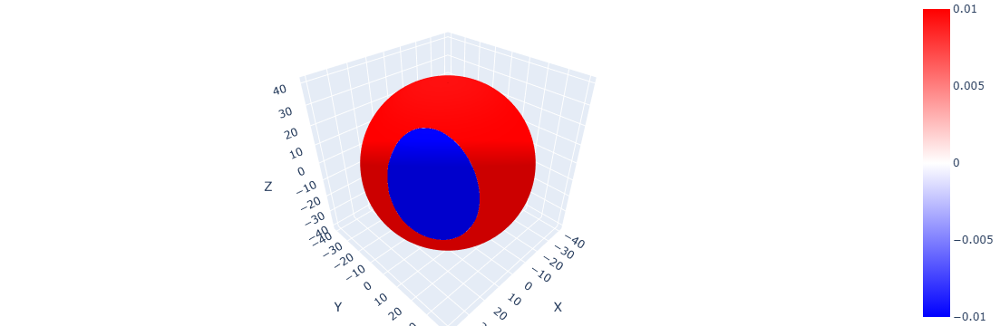

[[6.626281   6.62594811 6.62572733 ... 6.62458935 6.62542663 6.626281  ]
 [6.55706937 6.55657528 6.5562485  ... 6.55615994 6.5566127  6.55700046]
 [6.48787299 6.48712419 6.48666585 ... 6.48791529 6.48789373 6.48772336]
 ...
 [6.76006883 6.7601251  6.76019762 ... 6.76093722 6.76024939 6.75941772]
 [6.693193   6.69341921 6.69364806 ... 6.69441321 6.69367983 6.69286416]
 [6.626281   6.62664723 6.62700613 ... 6.62795171 6.62712479 6.626281  ]]


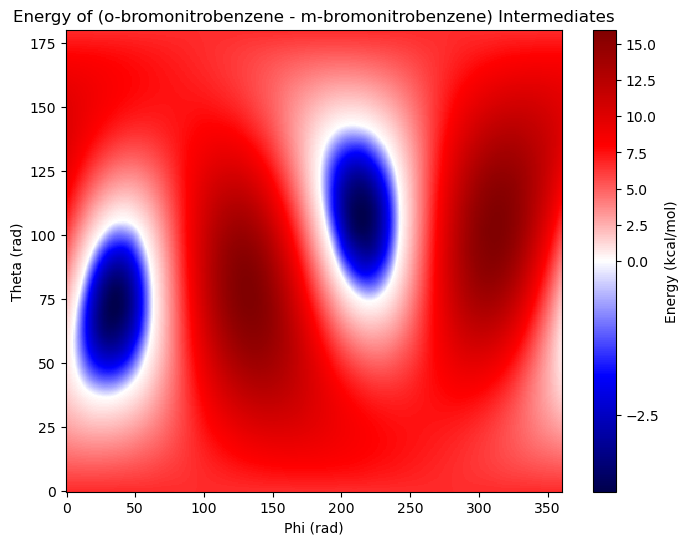

In [82]:
import numpy as np
import plotly.graph_objects as go

# Parameters
#phi = np.linspace(0, 2 * np.pi, 100)  # Azimuthal angle (x-axis)
#theta = np.linspace(0, np.pi, 50)    # Polar angle (y-axis)
#phi, theta = np.meshgrid(phi, theta)

# Example data function on (phi, theta) grid

# Define your vmin, vcenter, and vmax
vmin = -0.01 
vmax = 0.01  
vcenter = 0

# Define a Plotly colorscale similar to seismic
seismic_colorscale = [
    [0.0, "blue"],   # vmin -> Blue
    [0.5, "white"],  # vcenter -> White
    [1.0, "red"]     # vmax -> Red
]


thetas = np.deg2rad(np.array(theta))
phis = np.deg2rad(np.array(phi))
energy_diffs = np.array(energy_diff)

theta = np.array(theta)
phi = np.array(phi)
energy_diff = np.array(energy_diff)


# Spherical coordinates
R = 40# Radius of the sphere
X = R * np.sin(thetas) * np.cos(phis)
Y = R * np.sin(thetas) * np.sin(phis)
Z = R * np.cos(thetas)

fig = go.Figure(data=[go.Scatter3d(
    x=X,
    y=Y,
    z=Z,
    mode='markers',
    marker=dict(
        size=25,
        color=energy_diffs,                # set color to an array/list of desired values
        colorscale=seismic_colorscale,
        cmin=vmin,
        cmax=vmax,
        cmid=vcenter,  # This sets white at 0 # choose a colorscale
        opacity=1.0
    )
)])

# tight layout
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))
fig.show()




from scipy.interpolate import griddata
# Create a regular grid for interpolation
phi_lin = np.linspace(0, 2 * np.pi, 400)  # Regular azimuthal grid
theta_lin = np.linspace(0, np.pi, 400)    # Regular polar grid
phi_grid, theta_grid = np.meshgrid(phi_lin, theta_lin)

# Interpolate energy_diff onto the regular grid
energy_diff_grid = griddata(
    points=(thetas, phis),  # Original unorganized points
    values=energy_diffs,    # Values to interpolate
    xi=(theta_grid, phi_grid),  # Regular grid
    method='cubic'        # Interpolation method ('linear', 'nearest', 'cubic')
)

# Convert the regular spherical grid to Cartesian coordinates
X_grid = R * np.sin(theta_grid) * np.cos(phi_grid)
Y_grid = R * np.sin(theta_grid) * np.sin(phi_grid)
Z_grid = R * np.cos(theta_grid)

# Create a surface plot
fig = go.Figure(data=[go.Surface(
    x=X_grid,
    y=Y_grid,
    z=Z_grid,
    surfacecolor=energy_diff_grid,  # Color values
    colorscale=seismic_colorscale,
    cmin=vmin,
    cmax=vmax,
    cmid=vcenter,  # This sets white at 0 # choose a colorscale
)])

# Tight layout
fig.update_layout(
    scene=dict(
        xaxis_title='X',
        yaxis_title='Y',
        zaxis_title='Z'
    ),
    margin=dict(l=0, r=0, b=0, t=0)
)

fig.show()
print(energy_diff_grid)



from scipy.interpolate import griddata
# Create a regular grid for interpolation
phi_lin = np.linspace(0, np.rad2deg(2 * np.pi), 400)  # Regular azimuthal grid
theta_lin = np.linspace(0, np.rad2deg(np.pi), 400 )   # Regular polar grid
phi_grid, theta_grid = np.meshgrid(phi_lin, theta_lin)

# Interpolate energy_diff onto the regular grid
energy_diff_grid = griddata(
    points=(theta, phi),  # Original unorganized points
    values=energy_diff,    # Values to interpolate
    xi=(theta_grid, phi_grid),  # Regular grid
    method='cubic'        # Interpolation method ('linear', 'nearest', 'cubic')
)




from matplotlib.colors import TwoSlopeNorm

cmap = plt.get_cmap('seismic')
vmin = -0.0059619945216429875 * HARTREE_TO_kcal_mol
vmax = 0.025500426395924588 * HARTREE_TO_kcal_mol
vcenter = 0

norm = TwoSlopeNorm(vmin = vmin, vcenter=vcenter, vmax= vmax)

# Plot energies as a function of theta and phi using a 2D color plot
plt.figure(figsize=(8, 6))
plt.pcolormesh( phi_grid, theta_grid ,energy_diff_grid, shading='auto', cmap=cmap, norm = norm)
plt.colorbar(label='Energy (kcal/mol)')  # Add a color bar to represent the energy values
plt.xlabel('Phi (rad)')
plt.ylabel('Theta (rad)')
plt.title('Energy of (o-bromonitrobenzene - m-bromonitrobenzene) Intermediates')
plt.show()